In [2]:
 import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from statsmodels.datasets import get_rdataset
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.preprocessing import StandardScaler
import plotly.express as px
from sklearn.metrics.pairwise import euclidean_distances
from plotnine import *

In [3]:
 from sklearn.cluster import \
(KMeans,AgglomerativeClustering)
from scipy.cluster.hierarchy import \
(dendrogram,linkage,cut_tree)
from sklearn.datasets import make_blobs


### PCA and Dimensionality Reduction

In [4]:
wine_df = pd.read_csv(r'C:\Users\Anukul\Downloads\wine.csv')

In [5]:
wine_df.head()

,fixed.acidity,volatile.acidity,citric.acid,residual.sugar,chlorides,free.sulfur.dioxide,total.sulfur.dioxide,density,pH,sulphates,alcohol,quality,color
0,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,5,red
1,7.8,0.88,0.00,2.6,0.098,25.0,67.0,0.9968,3.20,0.68,9.8,5,red
2,7.8,0.76,0.04,2.3,0.092,15.0,54.0,0.9970,3.26,0.65,9.8,5,red
3,11.2,0.28,0.56,1.9,0.075,17.0,60.0,0.9980,3.16,0.58,9.8,6,red
4,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,5,red


In [6]:
selected_columns = wine_df.iloc[:, 0:11]

In [7]:
selected_columns.mean()

fixed.acidity             7.215307
volatile.acidity          0.339666
citric.acid               0.318633
residual.sugar            5.443235
chlorides                 0.056034
free.sulfur.dioxide      30.525319
total.sulfur.dioxide    115.744574
density                   0.994697
pH                        3.218501
sulphates                 0.531268
alcohol                  10.491801
dtype: float64

In [8]:
selected_columns.var()

fixed.acidity              1.680740
volatile.acidity           0.027105
citric.acid                0.021117
residual.sugar            22.636696
chlorides                  0.001227
free.sulfur.dioxide      315.041192
total.sulfur.dioxide    3194.720039
density                    0.000009
pH                         0.025853
sulphates                  0.022143
alcohol                    1.422561
dtype: float64

In [9]:
scaler = StandardScaler(with_std=True,with_mean=True)
wine_scaled = scaler.fit_transform(selected_columns)

In [10]:
init = range(10, 40,5)
inertia = []
for i in init:
    kmeans = KMeans(n_clusters = 2, random_state = 1, n_init = i)
    kmeans.fit(wine_scaled)
    inertia.append(kmeans.inertia_)
inertia_df = pd.DataFrame({"n_init" : init, "Inertia" : inertia})
inertia_df
  

,n_init,Inertia
0,10,56143.929379
1,15,56143.929379
2,20,56143.929379
3,25,56143.929379
4,30,56143.929379
5,35,56143.929379


Since the value of inertia does not depend on initialisations, we randomly select 25

In [11]:
    kmeans = KMeans(n_clusters = 2, random_state = 1, n_init = 25)
    kmeans.fit(wine_scaled)

KMeans(n_clusters=2, n_init=25, random_state=1)

In [12]:
wine_df["cluster"]=kmeans.labels_

In [13]:
wine_df.groupby('color').agg({
    'fixed.acidity':'mean',
    'volatile.acidity':'mean',
    'citric.acid':'mean',
    'residual.sugar':'mean',
    'chlorides':'mean',
    'free.sulfur.dioxide':'mean',
    'total.sulfur.dioxide':'mean',
    'density':'mean',
    'pH':'mean',
    'sulphates':'mean',
    'alcohol':'mean'})

,fixed.acidity,volatile.acidity,citric.acid,residual.sugar,chlorides,free.sulfur.dioxide,total.sulfur.dioxide,density,pH,sulphates,alcohol
color,,,,,,,,,,,
red,8.319637,0.527821,0.270976,2.538806,0.087467,15.874922,46.467792,0.996747,3.311113,0.658149,10.422983
white,6.854788,0.278241,0.334192,6.391415,0.045772,35.308085,138.360657,0.994027,3.188267,0.489847,10.514267


In [14]:
wine_df.groupby('cluster').agg({
    'fixed.acidity':'mean',
    'volatile.acidity':'mean',
    'citric.acid':'mean',
    'residual.sugar':'mean',
    'chlorides':'mean',
    'free.sulfur.dioxide':'mean',
    'total.sulfur.dioxide':'mean',
    'density':'mean',
    'pH':'mean',
    'sulphates':'mean',
    'alcohol':'mean'})

,fixed.acidity,volatile.acidity,citric.acid,residual.sugar,chlorides,free.sulfur.dioxide,total.sulfur.dioxide,density,pH,sulphates,alcohol
cluster,,,,,,,,,,,
0,8.290798,0.532212,0.269439,2.631079,0.088288,15.755941,48.544790,0.996742,3.309872,0.656740,10.402559
1,6.851864,0.274598,0.335257,6.393554,0.045134,35.516371,138.453563,0.994006,3.187624,0.488867,10.521958


Clusters made out of K means are comparable to the characteristics in the Column 'Color' in our dataset. Hence K Means created distinction similar to our dataset.

### PCA

Since, variables have vastly different means and variances, we transform the data using StandardScaler

In [15]:
PCAwine = PCA()

In [16]:
PCAwine.fit(wine_scaled)

PCA()

In [17]:
 PCAwine.components_

array([[-2.38798897e-01, -3.80757499e-01,  1.52388438e-01,
         3.45919930e-01, -2.90112586e-01,  4.30914008e-01,
         4.87418060e-01, -4.49366366e-02, -2.18686443e-01,
        -2.94135169e-01, -1.06437120e-01],
       [ 3.36354536e-01,  1.17549716e-01,  1.83299403e-01,
         3.29914181e-01,  3.15257992e-01,  7.19325988e-02,
         8.72662782e-02,  5.84037336e-01, -1.55869002e-01,
         1.91715769e-01, -4.65057692e-01],
       [ 4.34301304e-01, -3.07259420e-01,  5.90569674e-01,
        -1.64688429e-01, -1.66791047e-02, -1.34223949e-01,
        -1.07462297e-01, -1.75605553e-01, -4.55324122e-01,
         7.00424827e-02,  2.61100527e-01],
       [-1.64346214e-01, -2.12784888e-01,  2.64300312e-01,
        -1.67443015e-01,  2.44743855e-01,  3.57278939e-01,
         2.08420143e-01, -7.27249582e-02,  4.14551098e-01,
         6.40535710e-01,  1.06802696e-01],
       [ 1.47480376e-01, -1.51455988e-01,  1.55348697e-01,
         3.53361853e-01, -6.14391068e-01, -2.23532291e-01,
  

In [18]:
 scores = PCAwine.transform(wine_scaled)

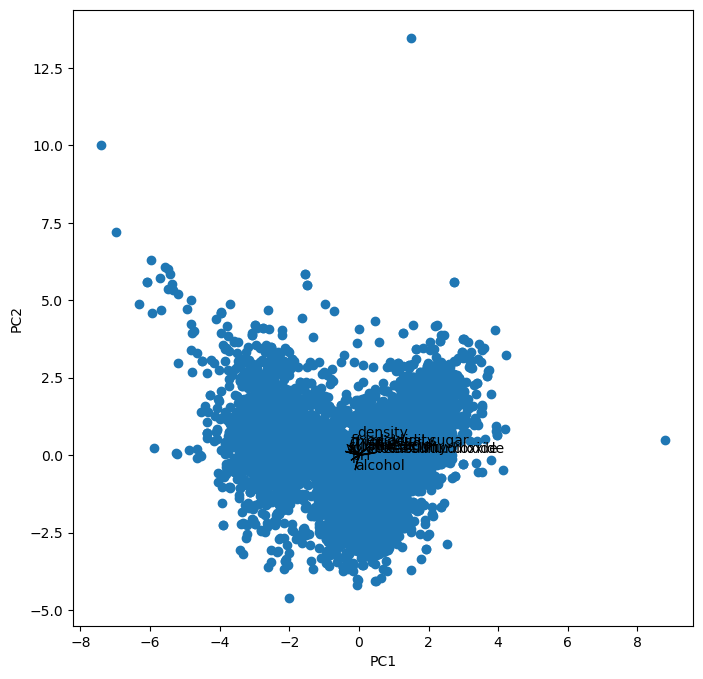

In [19]:
i, j = 0, 1 # which components
fig, ax = plt.subplots(1, 1, figsize=(8, 8))
ax.scatter(scores[:,0], scores[:,1])
ax.set_xlabel('PC%d' % (i+1))
ax.set_ylabel('PC%d' % (j+1))
for k in range( PCAwine.components_.shape[1]):
    ax.arrow(0, 0,  PCAwine.components_[i,k], PCAwine.components_[j,k])
    ax.text( PCAwine.components_[i,k],
    PCAwine.components_[j,k],
    wine_df.columns[k])

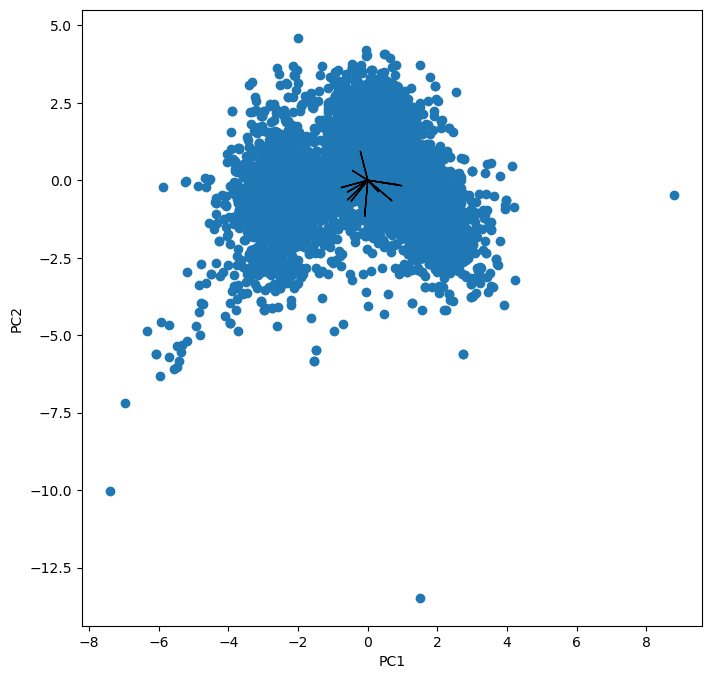

In [20]:
scale_arrow = s_ = 2
scores[:,1] *= -1
PCAwine.components_[1] *= -1 # flip the y-axis
fig, ax = plt.subplots(1, 1, figsize=(8, 8))
ax.scatter(scores[:,0], scores[:,1])
ax.set_xlabel('PC%d' % (i+1))
ax.set_ylabel('PC%d' % (j+1))
for k in range(PCAwine.components_.shape[1]):
    ax.arrow(0, 0, s_*PCAwine.components_[i,k], s_*PCAwine.components_[j,k])


In [21]:
PCAwine.explained_variance_

array([3.03033507, 2.49420993, 1.55658654, 0.97070149, 0.71998573,
       0.6074052 , 0.5232393 , 0.50158749, 0.33707593, 0.22773082,
       0.03283586])

In [22]:
PCAwine.explained_variance_ratio_

array([0.2754426 , 0.22671146, 0.14148609, 0.08823201, 0.06544317,
       0.05521016, 0.04755989, 0.04559184, 0.03063855, 0.02069961,
       0.00298462])

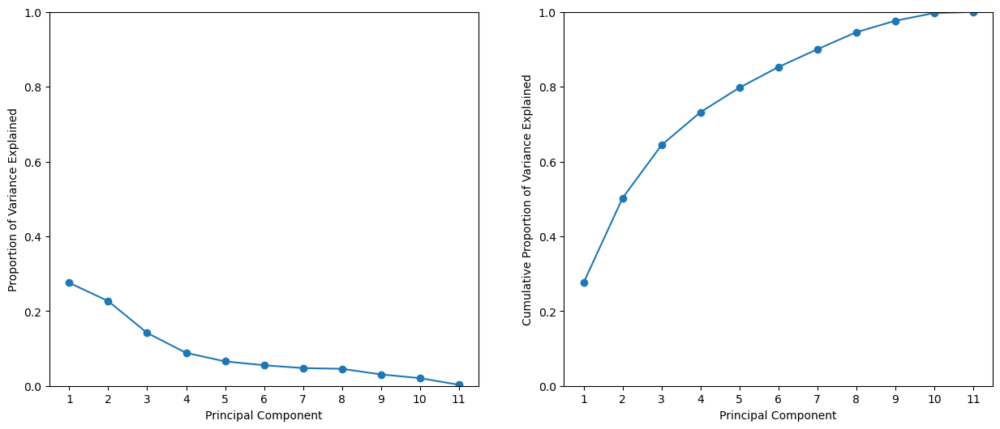

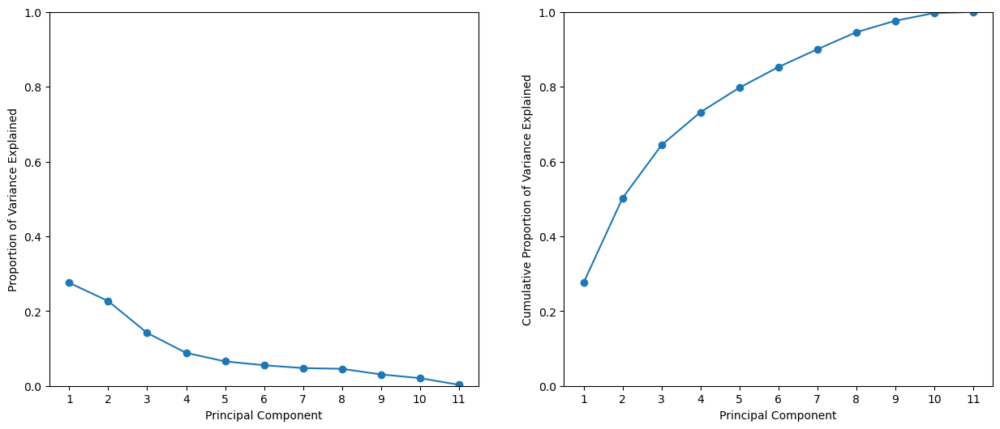

In [23]:
fig, axes = plt.subplots(1, 2, figsize=(15, 6))
ticks = np.arange(PCAwine.n_components_)+1
ax = axes[0]
ax.plot(ticks,PCAwine.explained_variance_ratio_,marker='o')
ax.set_xlabel('Principal Component');
ax.set_ylabel('Proportion of Variance Explained')
ax.set_ylim([0,1])
ax.set_xticks(ticks)

ax = axes[1]
ax.plot(ticks,PCAwine.explained_variance_ratio_.cumsum(),marker='o')
ax.set_xlabel('Principal Component')
ax.set_ylabel('Cumulative Proportion of Variance Explained')
ax.set_ylim([0, 1])
ax.set_xticks(ticks)
fig

The first four components amount for 73% of the data so, we selected the first 4 components

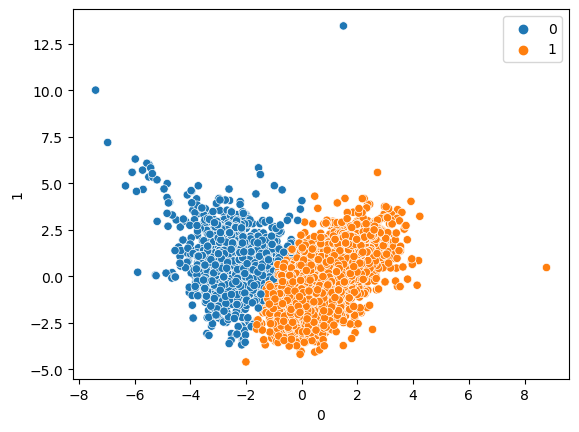

In [24]:
df_pca = pd.DataFrame(PCA(4).fit_transform(wine_scaled))
kmeans = KMeans(n_clusters = 2, random_state = 1, n_init = 25)
kmeans.fit(df_pca)
pca_labels = kmeans.labels_
sns.scatterplot(data = df_pca, x = df_pca.iloc[:, 0],y = df_pca.iloc[:, 1], hue = pca_labels)
plt.show()

In [25]:
wine_df['pca_Cluster']=pca_labels

In [26]:
wine_df['pca_Cluster'] = wine_df['pca_Cluster'].replace(0, 'red')
wine_df['pca_Cluster'] = wine_df['pca_Cluster'].replace(1, 'white')

In [27]:
wine_df.head()

,fixed.acidity,volatile.acidity,citric.acid,residual.sugar,chlorides,free.sulfur.dioxide,total.sulfur.dioxide,density,pH,sulphates,alcohol,quality,color,cluster,pca_Cluster
0,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,5,red,0,red
1,7.8,0.88,0.00,2.6,0.098,25.0,67.0,0.9968,3.20,0.68,9.8,5,red,0,red
2,7.8,0.76,0.04,2.3,0.092,15.0,54.0,0.9970,3.26,0.65,9.8,5,red,0,red
3,11.2,0.28,0.56,1.9,0.075,17.0,60.0,0.9980,3.16,0.58,9.8,6,red,0,red
4,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,5,red,0,red


In [28]:
equal_count = (wine_df['color'] == wine_df['pca_Cluster']).sum()

In [29]:
equal_count/wine_df['color'].count()

0.9839926119747576

K Means Clustering after PCA gave an accuracy of 98.4%.

### t-SNE

In [30]:
tsne = TSNE(n_components=2, verbose=1, perplexity=30, n_iter=1000, learning_rate=200)


tsne_results = tsne.fit_transform(wine_scaled)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 6497 samples in 0.015s...
[t-SNE] Computed neighbors for 6497 samples in 1.291s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6497
[t-SNE] Computed conditional probabilities for sample 2000 / 6497
[t-SNE] Computed conditional probabilities for sample 3000 / 6497
[t-SNE] Computed conditional probabilities for sample 4000 / 6497
[t-SNE] Computed conditional probabilities for sample 5000 / 6497
[t-SNE] Computed conditional probabilities for sample 6000 / 6497
[t-SNE] Computed conditional probabilities for sample 6497 / 6497
[t-SNE] Mean sigma: 0.697145
[t-SNE] KL divergence after 250 iterations with early exaggeration: 82.146950
[t-SNE] KL divergence after 1000 iterations: 1.409052


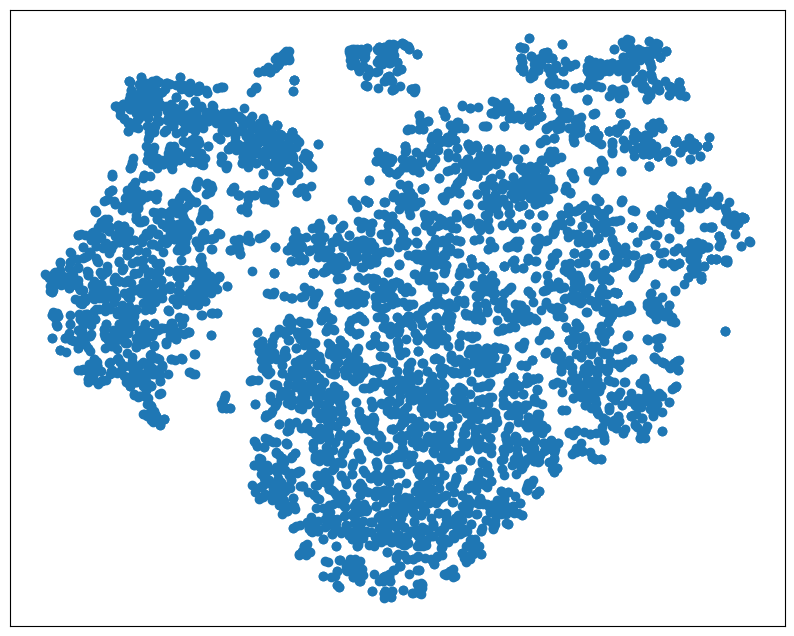

In [31]:
plt.figure(figsize=(10,8))
plt.scatter(tsne_results[:, 0], tsne_results[:, 1])
plt.xticks([])
plt.yticks([])
plt.show()

In [32]:
tsne_df = pd.DataFrame(data = tsne_results, columns = ['Dim1', 'Dim2'])

tsne_df['color'] = wine_df['color'].values

fig = px.scatter(tsne_df, x='Dim1', y='Dim2', hover_data=['color'])
fig.show()

In [33]:
tsne_df['quality'] = wine_df['quality'].values

fig = px.scatter(tsne_df, x='Dim1', y='Dim2', color='quality', hover_data=['color'])
fig.show()

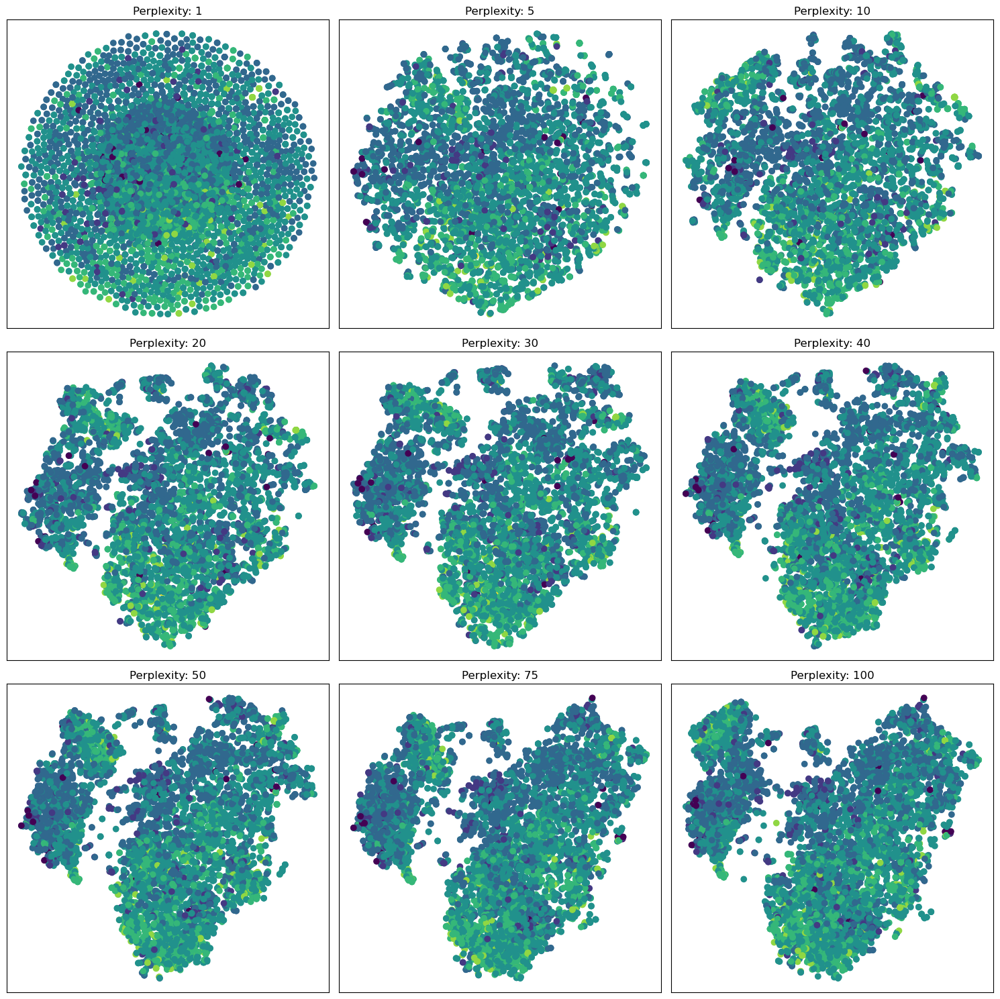

In [34]:
# define perplexity values to use
perplexities = [1, 5, 10, 20, 30, 40, 50, 75, 100]

# create a 3x3 grid of subplots
fig, axs = plt.subplots(3, 3, figsize=(15,15))

# reshape axs to 1D array
axs = axs.flatten()

for i, perplexity in enumerate(perplexities):
    # run t-SNE with the specified perplexity
    tsne = TSNE(n_components=2, perplexity=perplexity, n_iter=1000, learning_rate=200)
    tsne_results = tsne.fit_transform(wine_scaled)
    
    # convert the t-SNE results to a pandas DataFrame
    tsne_df = pd.DataFrame(data = tsne_results, columns = ['Dim1', 'Dim2'])

    # add the categories to this DataFrame
    tsne_df['quality'] = wine_df['quality'].values

    # create a scatter plot in the corresponding subplot
    scatter = axs[i].scatter(tsne_df['Dim1'], tsne_df['Dim2'], c=tsne_df['quality'])
    axs[i].set_title(f'Perplexity: {perplexity}')
    axs[i].set_xticks([])
    axs[i].set_yticks([])

# show the plot
plt.tight_layout()
plt.show()

Based on the plots, t-SNE appears to have created distinct clusters. Thus, it looks like a better way to segregate data into Red and White Wine.

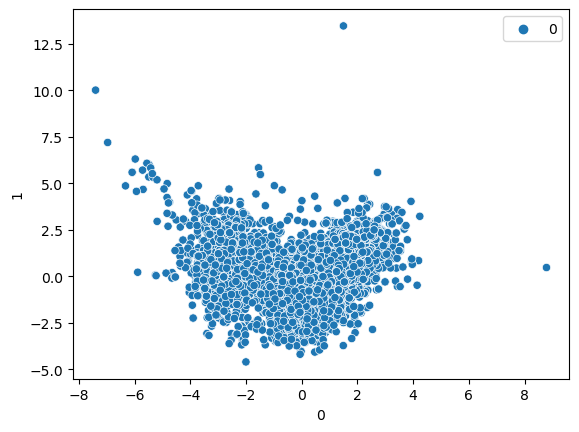

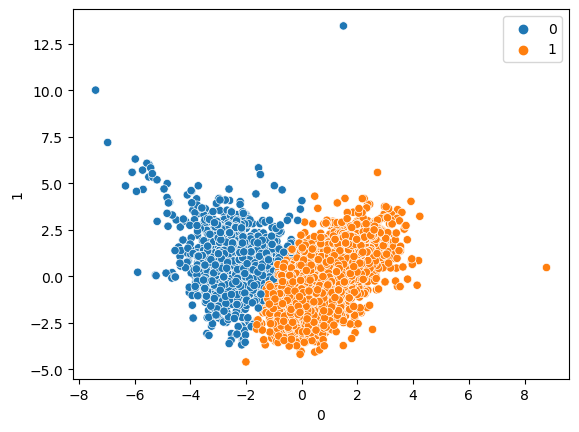

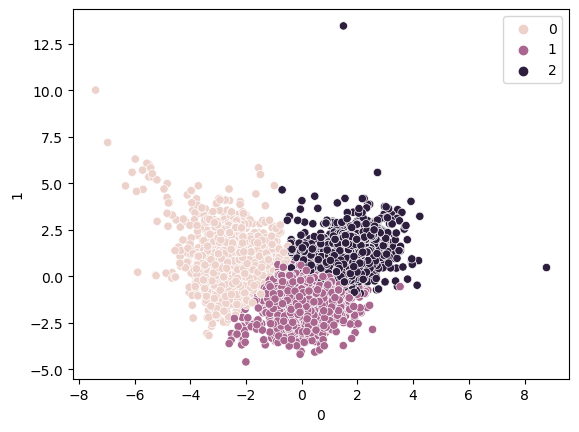

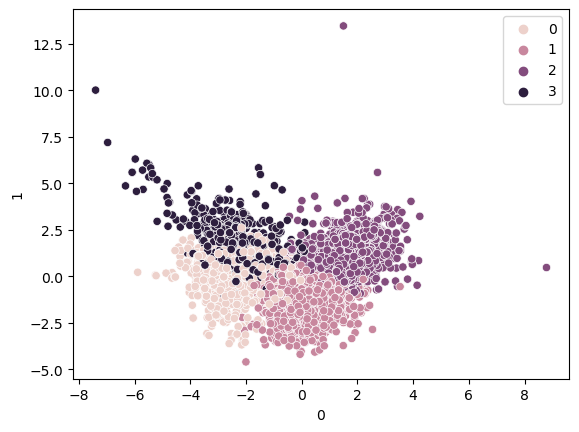

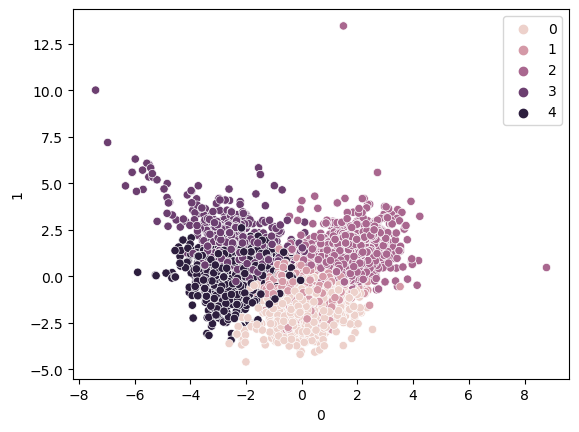

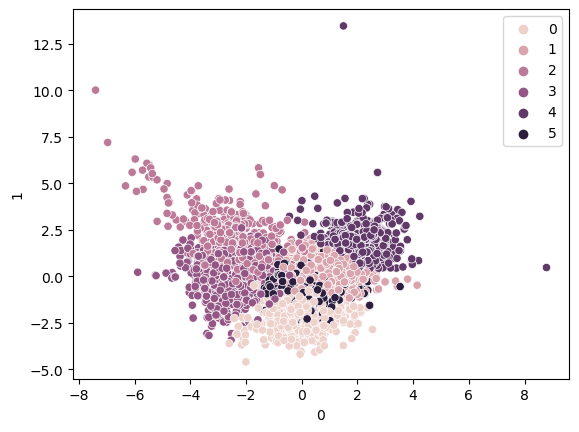

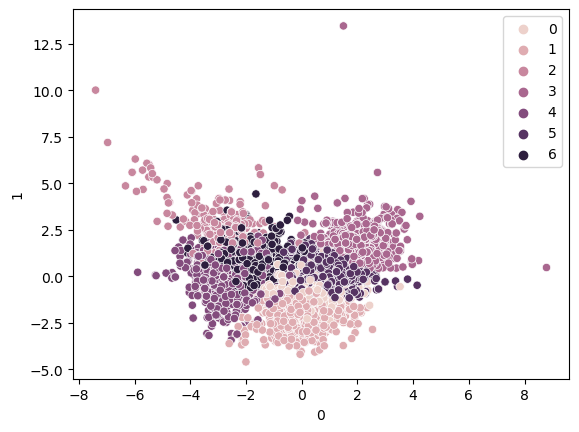

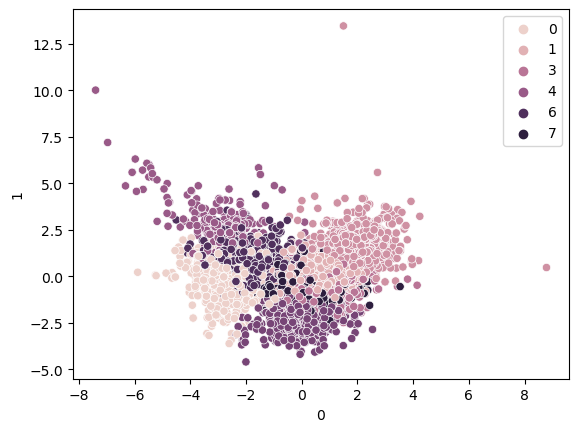

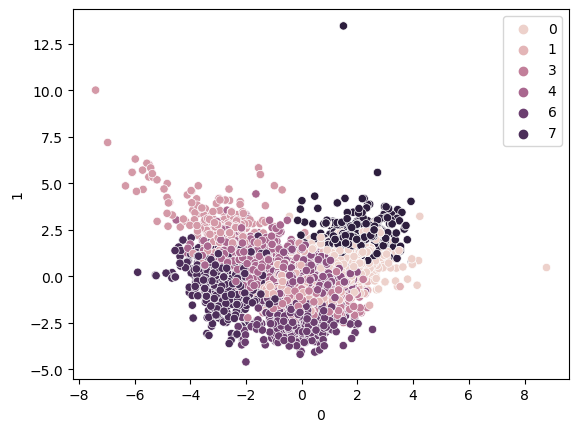

In [35]:
df_pca2 = pd.DataFrame(PCA(4).fit_transform(wine_scaled))

for i in range(1,10):
    kmeans = KMeans(n_clusters = i, random_state = 1, n_init = 25)
    kmeans.fit(df_pca)
    pca2_labels = kmeans.labels_
    sns.scatterplot(data = df_pca2, x = df_pca2.iloc[:, 0],y = df_pca2.iloc[:, 1], hue = pca2_labels)
    plt.show()

For quality, the clusters saturated at 7 clusters. This is because quality only has 7 values. 1,2 and 10 are not present in the data.

In [36]:
wine_df['quality_pca'] = pca2_labels

In [56]:
wine_df.groupby('quality').agg({
    'fixed.acidity':'mean',
    'volatile.acidity':'mean',
    'citric.acid':'mean',
    'residual.sugar':'mean',
    'chlorides':'mean',
    'free.sulfur.dioxide':'mean',
    'total.sulfur.dioxide':'mean',
    'density':'mean',
    'pH':'mean',
    'sulphates':'mean',
    'alcohol':'mean'})

,fixed.acidity,volatile.acidity,citric.acid,residual.sugar,chlorides,free.sulfur.dioxide,total.sulfur.dioxide,density,pH,sulphates,alcohol
quality,,,,,,,,,,,
3,7.853333,0.517000,0.281000,5.140000,0.077033,39.216667,122.033333,0.995744,3.257667,0.506333,10.215000
4,7.288889,0.457963,0.272315,4.153704,0.060056,20.636574,103.432870,0.994833,3.231620,0.505648,10.180093
5,7.326801,0.389614,0.307722,5.804116,0.064666,30.237371,120.839102,0.995849,3.212189,0.526403,9.837783
6,7.177257,0.313863,0.323583,5.549753,0.054157,31.165021,115.410790,0.994558,3.217726,0.532549,10.587553
7,7.128962,0.288800,0.334764,4.731696,0.045272,30.422150,108.498610,0.993126,3.228072,0.547025,11.386006
8,6.835233,0.291010,0.332539,5.382902,0.041124,34.533679,117.518135,0.992514,3.223212,0.512487,11.678756
9,7.420000,0.298000,0.386000,4.120000,0.027400,33.400000,116.000000,0.991460,3.308000,0.466000,12.180000


In [57]:
wine_df.groupby('quality_pca').agg({
    'fixed.acidity':'mean',
    'volatile.acidity':'mean',
    'citric.acid':'mean',
    'residual.sugar':'mean',
    'chlorides':'mean',
    'free.sulfur.dioxide':'mean',
    'total.sulfur.dioxide':'mean',
    'density':'mean',
    'pH':'mean',
    'sulphates':'mean',
    'alcohol':'mean'})

,fixed.acidity,volatile.acidity,citric.acid,residual.sugar,chlorides,free.sulfur.dioxide,total.sulfur.dioxide,density,pH,sulphates,alcohol
quality_pca,,,,,,,,,,,
0,6.663636,0.272592,0.328415,9.771499,0.052695,52.944103,182.152948,0.996373,3.225369,0.509889,9.635770
1,7.608070,0.250994,0.393275,3.521696,0.040303,25.581287,112.411696,0.992380,3.070760,0.462994,11.146803
2,10.949645,0.429096,0.531454,2.943617,0.122989,12.648936,39.191489,0.998627,3.134433,0.806702,10.405556
3,6.423613,0.246381,0.318101,3.174291,0.043864,38.061652,141.262639,0.992908,3.339162,0.569075,10.706042
4,8.435098,0.457731,0.350424,2.600454,0.084681,17.590015,59.208775,0.996725,3.274871,0.655870,10.360666
5,6.907769,0.316629,0.268471,6.888910,0.049564,27.820175,128.565163,0.994809,3.164662,0.442845,9.961086
6,6.319610,0.295119,0.297096,2.743391,0.035164,27.182557,104.091008,0.990482,3.243294,0.470358,12.119429
7,7.092604,0.646013,0.088195,2.362500,0.078738,15.040680,41.646450,0.995979,3.410237,0.592692,10.330646
8,7.290694,0.273516,0.412142,14.253693,0.052043,44.069424,171.389956,0.998464,3.070473,0.487459,9.168587


In [58]:
wine_df.groupby('quality').agg({
    'fixed.acidity':'median',
    'volatile.acidity':'median',
    'citric.acid':'median',
    'residual.sugar':'median',
    'chlorides':'median',
    'free.sulfur.dioxide':'mean',
    'total.sulfur.dioxide':'median',
    'density':'median',
    'pH':'median',
    'sulphates':'median',
    'alcohol':'median'})

,fixed.acidity,volatile.acidity,citric.acid,residual.sugar,chlorides,free.sulfur.dioxide,total.sulfur.dioxide,density,pH,sulphates,alcohol
quality,,,,,,,,,,,
3,7.45,0.415,0.33,3.15,0.0550,39.216667,102.5,0.995900,3.245,0.505,10.15
4,7.00,0.380,0.26,2.20,0.0505,20.636574,102.0,0.994995,3.220,0.485,10.00
5,7.10,0.330,0.30,3.00,0.0530,30.237371,127.0,0.996100,3.190,0.500,9.60
6,6.90,0.270,0.31,3.10,0.0460,31.165021,117.0,0.994700,3.210,0.510,10.50
7,6.90,0.270,0.32,2.80,0.0390,30.422150,114.0,0.992400,3.220,0.520,11.40
8,6.80,0.280,0.32,4.10,0.0370,34.533679,118.0,0.991890,3.230,0.480,12.00
9,7.10,0.270,0.36,2.20,0.0310,33.400000,119.0,0.990300,3.280,0.460,12.50


In [59]:
wine_df.groupby('quality_pca').agg({
    'fixed.acidity':'median',
    'volatile.acidity':'median',
    'citric.acid':'median',
    'residual.sugar':'median',
    'chlorides':'median',
    'free.sulfur.dioxide':'mean',
    'total.sulfur.dioxide':'median',
    'density':'median',
    'pH':'median',
    'sulphates':'median',
    'alcohol':'median'})

,fixed.acidity,volatile.acidity,citric.acid,residual.sugar,chlorides,free.sulfur.dioxide,total.sulfur.dioxide,density,pH,sulphates,alcohol
quality_pca,,,,,,,,,,,
0,6.6,0.26,0.31,8.9,0.047,52.944103,181.0,0.99610,3.20,0.50,9.5
1,7.5,0.24,0.37,2.0,0.038,25.581287,111.0,0.99237,3.06,0.45,11.1
2,10.9,0.41,0.51,2.4,0.089,12.648936,27.0,0.99860,3.15,0.75,10.2
3,6.4,0.24,0.31,2.0,0.043,38.061652,141.0,0.99280,3.33,0.56,10.7
4,8.3,0.43,0.34,2.2,0.080,17.590015,49.0,0.99680,3.27,0.63,10.1
5,6.8,0.30,0.27,6.9,0.047,27.820175,128.0,0.99474,3.16,0.44,9.8
6,6.4,0.28,0.30,2.0,0.034,27.182557,103.0,0.99045,3.24,0.45,12.2
7,7.1,0.63,0.07,2.1,0.077,15.040680,35.0,0.99610,3.39,0.58,10.0
8,7.3,0.26,0.37,14.2,0.049,44.069424,169.0,0.99828,3.07,0.47,9.1


Even though we get the right amount of clusters in the dataset. Further analysis of the mean and median of the clusters made suggest that quality was not defined accurately using Unsupervised Learning. While we get the segregation at the face value. Further deepdive suggests that the right accuracy could not be achieved and that the segmentation is not reliable.

### Market Segmentation

In [38]:
ms_df = pd.read_csv(r'C:\Users\Anukul\Downloads\social_marketing.csv')

In [39]:
pd.set_option('display.max_columns', None)

In [40]:
ms_df.iloc[:,1:].describe()

,chatter,current_events,travel,photo_sharing,uncategorized,tv_film,sports_fandom,politics,food,family,home_and_garden,music,news,online_gaming,shopping,health_nutrition,college_uni,sports_playing,cooking,eco,computers,business,outdoors,crafts,automotive,art,religion,beauty,parenting,dating,school,personal_fitness,fashion,small_business,spam,adult
count,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000
mean,4.398757,1.526262,1.585004,2.696777,0.812992,1.070287,1.594012,1.788632,1.397488,0.863867,0.520680,0.679269,1.205532,1.208830,1.389368,2.567242,1.549480,0.639178,1.998224,0.512307,0.649074,0.423243,0.782669,0.515859,0.829866,0.724816,1.095407,0.705151,0.921340,0.710860,0.767699,1.462065,0.996574,0.336336,0.006470,0.403324
std,3.529126,1.268890,2.285530,2.731510,0.935853,1.658783,2.160917,3.031113,1.775557,1.132562,0.736691,1.030015,2.100780,2.687465,1.808846,4.496144,2.897154,0.975517,3.429941,0.769725,1.179453,0.692379,1.209483,0.816848,1.366151,1.629576,1.914829,1.327903,1.515359,1.782347,1.188259,2.405244,1.828412,0.618147,0.083288,1.813428
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,2.000000,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,3.000000,1.000000,1.000000,2.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,6.000000,2.000000,2.000000,4.000000,1.000000,1.000000,2.000000,2.000000,2.000000,1.000000,1.000000,1.000000,1.000000,1.000000,2.000000,3.000000,2.000000,1.000000,2.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,2.000000,1.000000,1.000000,0.000000,0.000000
max,26.000000,8.000000,26.000000,21.000000,9.000000,17.000000,20.000000,37.000000,16.000000,10.000000,5.000000,13.000000,20.000000,27.000000,12.000000,41.000000,30.000000,8.000000,33.000000,6.000000,16.000000,6.000000,12.000000,7.000000,13.000000,18.000000,20.000000,14.000000,14.000000,24.000000,11.000000,19.000000,18.000000,6.000000,2.000000,26.000000


Dropping spam and adult column to remove unwanted bias in the clusters

In [41]:
ms_df_dropped = ms_df.drop(columns=['spam','adult'], axis=1).copy()

In [42]:
ms_df_dropped

,Unnamed: 0,chatter,current_events,travel,photo_sharing,uncategorized,tv_film,sports_fandom,politics,food,family,home_and_garden,music,news,online_gaming,shopping,health_nutrition,college_uni,sports_playing,cooking,eco,computers,business,outdoors,crafts,automotive,art,religion,beauty,parenting,dating,school,personal_fitness,fashion,small_business
0,hmjoe4g3k,2,0,2,2,2,1,1,0,4,1,2,0,0,0,1,17,0,2,5,1,1,0,2,1,0,0,1,0,1,1,0,11,0,0
1,clk1m5w8s,3,3,2,1,1,1,4,1,2,2,1,0,0,0,0,0,0,1,0,0,0,1,0,2,0,0,0,0,0,1,4,0,0,0
2,jcsovtak3,6,3,4,3,1,5,0,2,1,1,1,1,1,0,2,0,0,0,2,1,0,0,0,2,0,8,0,1,0,1,0,0,1,0
3,3oeb4hiln,1,5,2,2,0,1,0,1,0,1,0,0,0,0,0,0,1,0,0,0,0,1,0,3,0,2,0,1,0,0,0,0,0,0
4,fd75x1vgk,5,2,0,6,1,0,0,2,0,1,0,0,0,3,2,0,4,0,1,0,1,0,1,0,0,0,0,0,0,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7877,y3ijoqfgd,5,4,2,1,0,1,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,2,0,0
7878,n6gud4ext,9,3,2,4,0,1,0,4,1,3,0,3,5,0,3,4,0,0,2,0,3,1,2,0,0,0,0,1,0,1,0,5,0,1
7879,f71rt6cyg,3,2,1,1,0,4,1,2,1,0,3,0,1,1,2,8,2,0,2,0,1,0,3,1,0,0,1,0,1,1,0,6,1,0
7880,gevsyip7o,3,2,0,4,0,0,1,1,1,1,0,0,1,1,2,1,0,0,0,0,3,0,1,0,0,3,0,0,1,0,0,1,1,0


In [43]:
correlation_matrix = ms_df_dropped.corr()

C:\Users\Anukul\AppData\Local\Temp\ipykernel_27184\3619560031.py:1: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



In [44]:
print(correlation_matrix)

                   chatter  current_events    travel  photo_sharing  \
chatter           1.000000        0.156211  0.014667       0.536267   
current_events    0.156211        1.000000  0.050946       0.145953   
travel            0.014667        0.050946  1.000000       0.024068   
photo_sharing     0.536267        0.145953  0.024068       1.000000   
uncategorized     0.066993        0.029674  0.030866       0.096398   
tv_film           0.012899        0.077673  0.096990       0.021171   
sports_fandom     0.014393        0.061780 -0.008709       0.019921   
politics          0.051448        0.068283  0.660210       0.039767   
food             -0.004704        0.059768  0.075142       0.006802   
family            0.079170        0.063367  0.017535       0.098588   
home_and_garden   0.070158        0.053511  0.040932       0.083955   
music             0.091318        0.072366  0.038640       0.146188   
news             -0.001164        0.060284  0.250617      -0.011980   
online

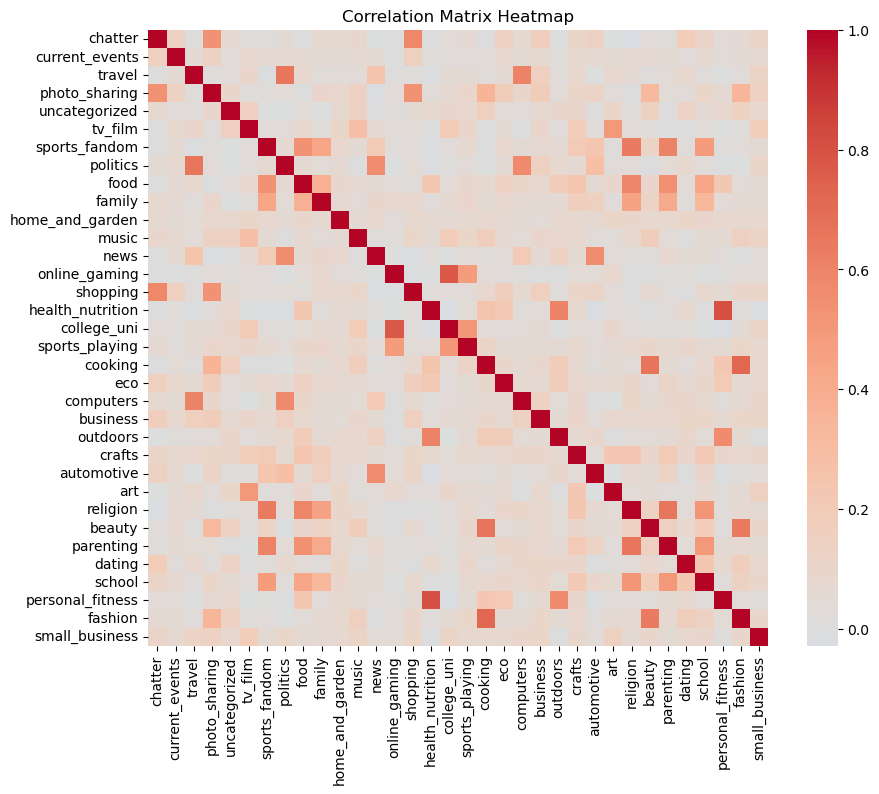

In [45]:
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, cmap='coolwarm', center=0)
plt.title("Correlation Matrix Heatmap")
plt.show()

Key conclusions from the correlation matrix:


1. **Moderate Positive Correlations:**
   - "travel" has a moderate positive correlation (0.66) with "politics," suggesting that people interested in travel may also be interested in politics.
   - "sports_fandom" and "family" have a moderate positive correlation (0.438), indicating that those interested in sports fandom also tend to have interests related to family.

2. **Positive Correlations:**
   - "politics" and "travel" have a positive correlation (0.66), indicating that people interested in politics may also be interested in travel.
   - "music" and "tv_film" are positively correlated (0.275), suggesting an overlap between interests in music and television/film.
   - There is a positive correlation (0.536) between "sports_fandom" and "food," indicating a potential connection between sports interests and food-related interests.

3. **Other Insights:**
   - "health_nutrition" and "personal_fitness" have a notable positive correlation (0.81), suggesting a strong association between health-related interests and personal fitness.
   - "uncategorized" and "tv_film" have a positive correlation (0.163), indicating that uncategorized interests may also align with interests in television and film.
   - "college_uni" and "online_gaming" have a relatively high positive correlation (0.773), suggesting that college or university-related interests may be associated with online gaming.

These conclusions provide insights into potential patterns of user interests and correlations between different content categories. Keep in mind that correlation does not imply causation, so these relationships should be interpreted cautiously and further analyzed if needed.

Dropping Uncategorized, Home_and_garden and Small_business after assessing correlation matrix

In [46]:
ms_df_kmeans=ms_df_dropped.drop(columns=['home_and_garden','uncategorized','small_business','Unnamed: 0'], axis=1).copy()

In [47]:
ms_df_kmeans.describe()

,chatter,current_events,travel,photo_sharing,tv_film,sports_fandom,politics,food,family,music,news,online_gaming,shopping,health_nutrition,college_uni,sports_playing,cooking,eco,computers,business,outdoors,crafts,automotive,art,religion,beauty,parenting,dating,school,personal_fitness,fashion
count,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000,7882.000000
mean,4.398757,1.526262,1.585004,2.696777,1.070287,1.594012,1.788632,1.397488,0.863867,0.679269,1.205532,1.208830,1.389368,2.567242,1.549480,0.639178,1.998224,0.512307,0.649074,0.423243,0.782669,0.515859,0.829866,0.724816,1.095407,0.705151,0.921340,0.710860,0.767699,1.462065,0.996574
std,3.529126,1.268890,2.285530,2.731510,1.658783,2.160917,3.031113,1.775557,1.132562,1.030015,2.100780,2.687465,1.808846,4.496144,2.897154,0.975517,3.429941,0.769725,1.179453,0.692379,1.209483,0.816848,1.366151,1.629576,1.914829,1.327903,1.515359,1.782347,1.188259,2.405244,1.828412
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,2.000000,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,3.000000,1.000000,1.000000,2.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,6.000000,2.000000,2.000000,4.000000,1.000000,2.000000,2.000000,2.000000,1.000000,1.000000,1.000000,1.000000,2.000000,3.000000,2.000000,1.000000,2.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,2.000000,1.000000
max,26.000000,8.000000,26.000000,21.000000,17.000000,20.000000,37.000000,16.000000,10.000000,13.000000,20.000000,27.000000,12.000000,41.000000,30.000000,8.000000,33.000000,6.000000,16.000000,6.000000,12.000000,7.000000,13.000000,18.000000,20.000000,14.000000,14.000000,24.000000,11.000000,19.000000,18.000000


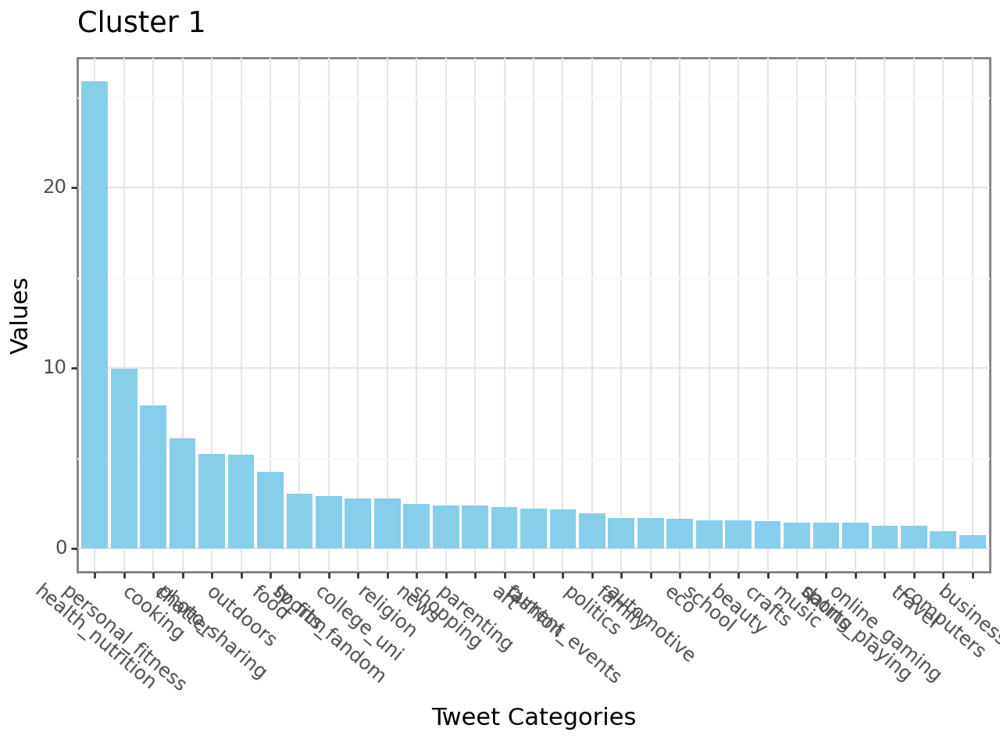

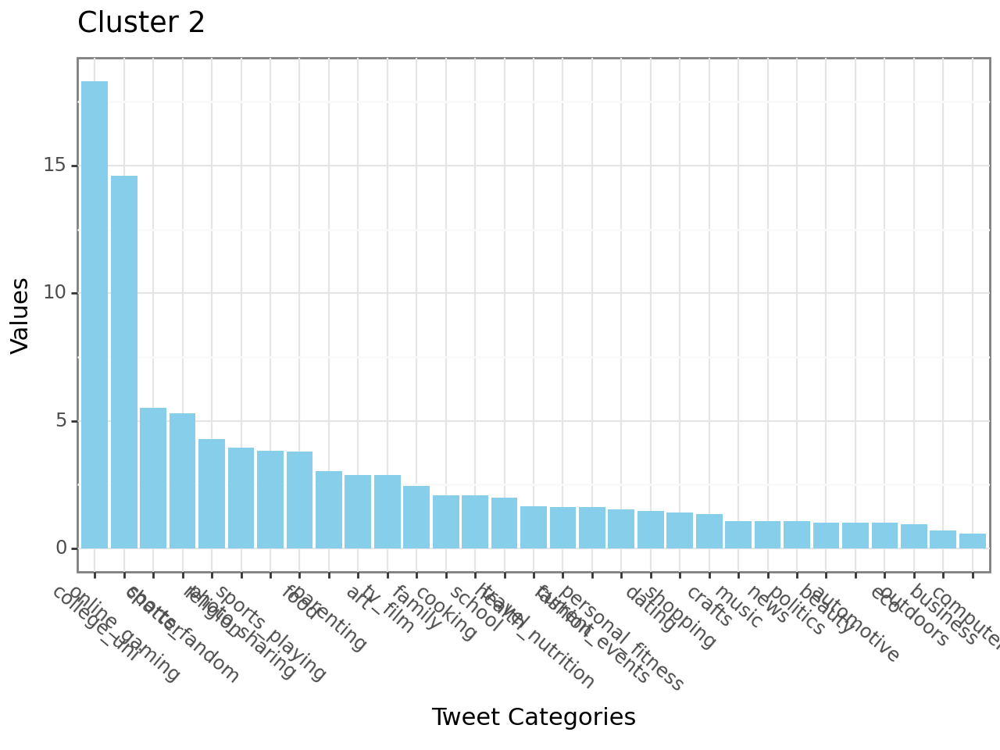

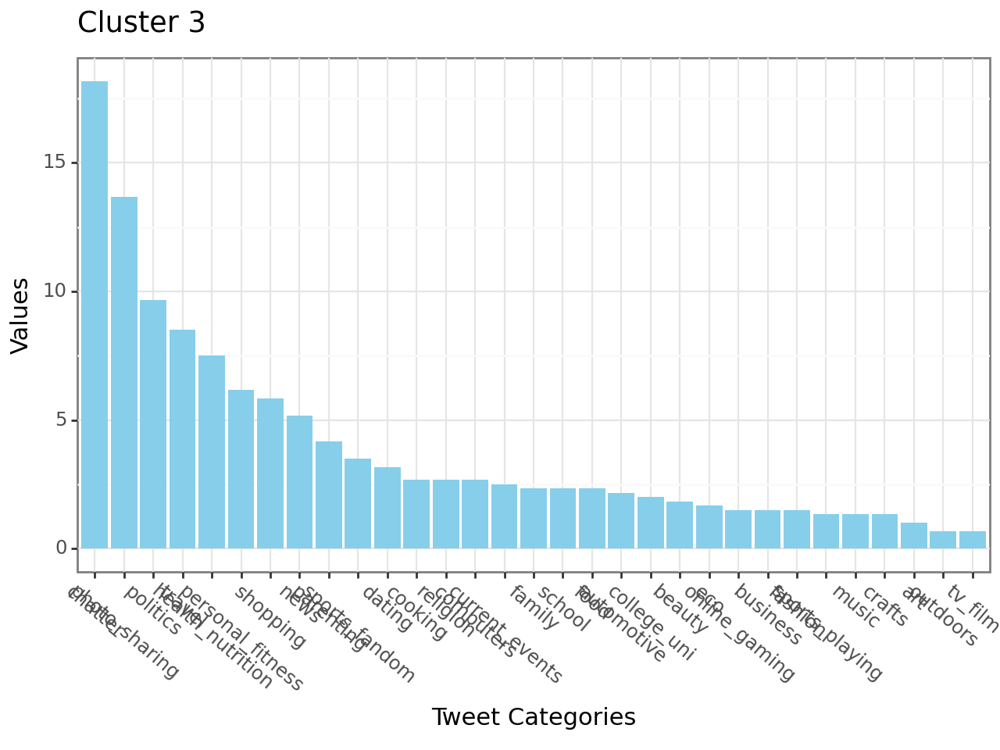

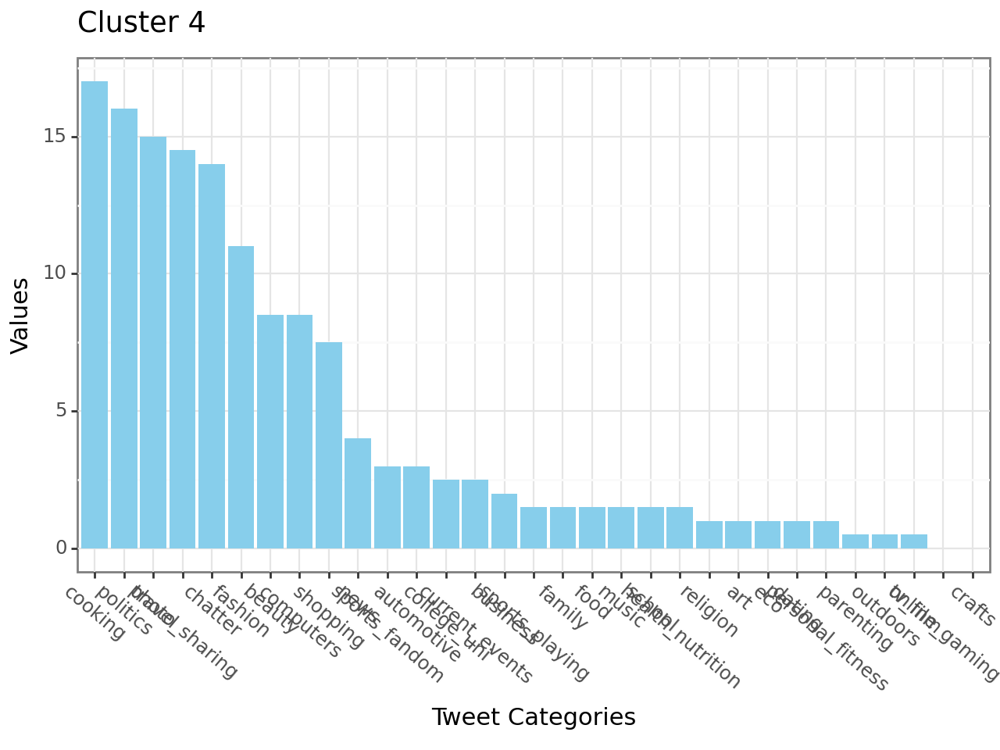

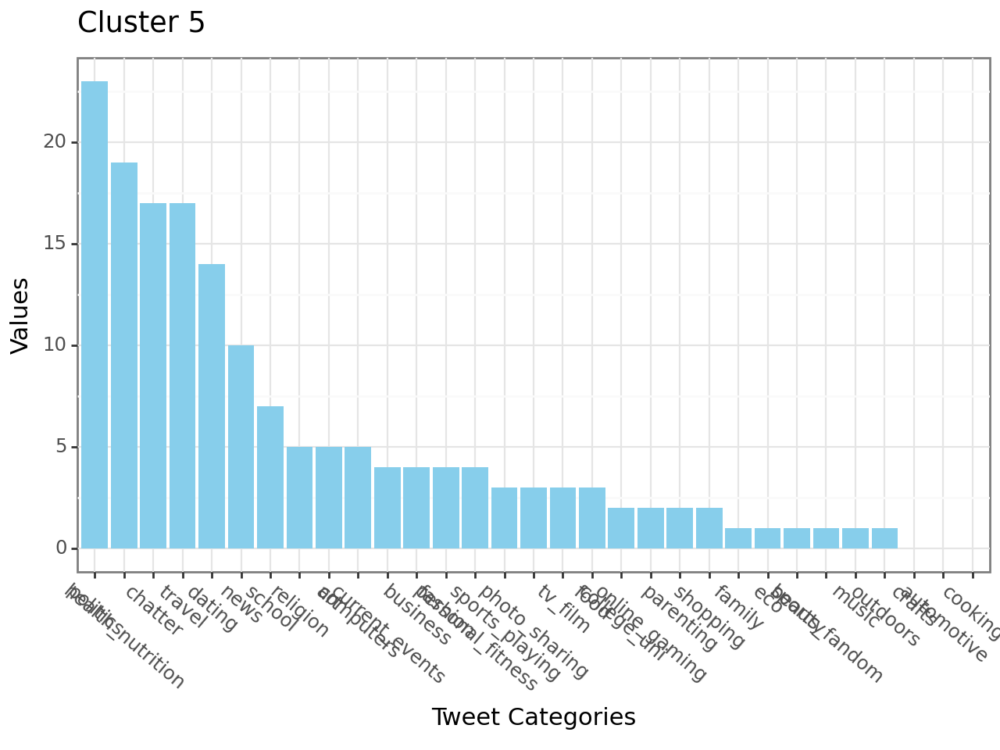

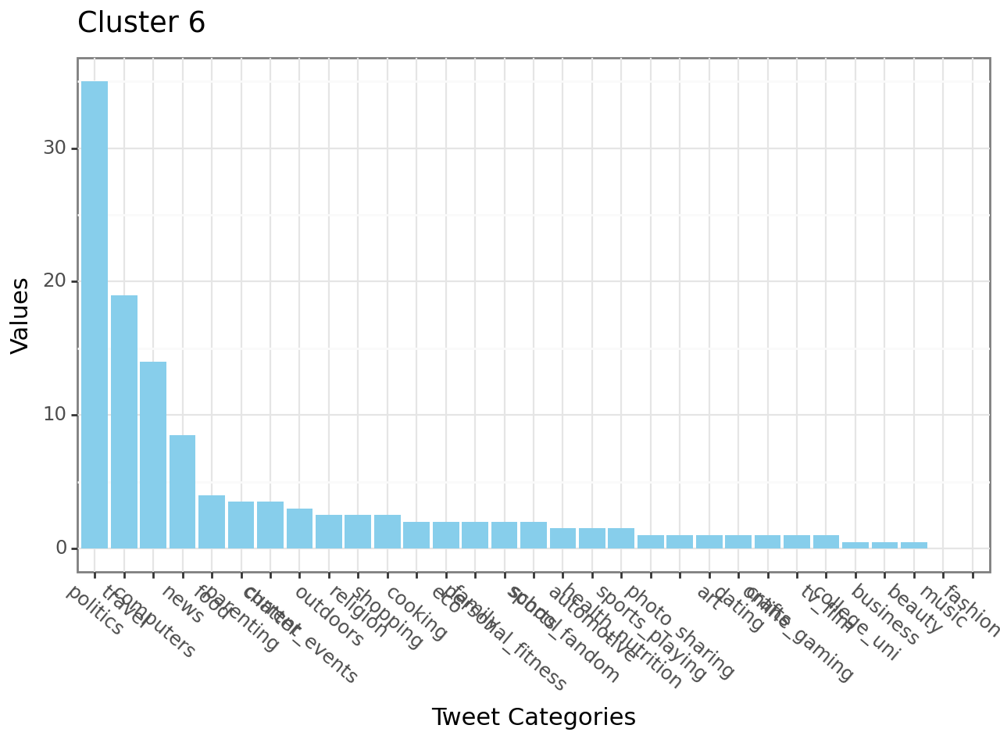

In [48]:

data = ms_df_kmeans
columns = data.columns


dist_mat = linkage(data, method='average')
clustercut = cut_tree(dist_mat, n_clusters=7).flatten()


ms_df_kmeans['Cluster'] = clustercut


avg = ms_df_kmeans.groupby('Cluster')[columns].mean().T
avg.columns = ['Clust_' + str(i) for i in avg.columns]


avg = avg.reset_index()


avg_long = pd.melt(avg, id_vars=['index'], var_name='Cluster', value_name='Value')


plots = []
for i in range(1, 7):
    cluster_name = 'Clust_' + str(i)
    p = (
        ggplot(avg_long[avg_long['Cluster'] == cluster_name], aes(x='reorder(index, -Value)', y='Value')) +
        geom_bar(stat='identity', position='dodge', fill='skyblue') +
        theme_bw() +
        theme(axis_text_x=element_text(angle=-40, hjust=0.1)) +
        labs(title=f'Cluster {i}', x='Tweet Categories', y='Values')
    )
    plots.append(p)


for p in plots:
    print(p)


In a lot of clusters we are getting "Chatter" as a tweet category which is not very helpful. Hence, we will drop it and then run PCA.

In [49]:
ms_df_pca=ms_df_kmeans.drop(columns=['chatter','Cluster'], axis=1)

In [50]:
scaler = StandardScaler(with_std=True,with_mean=True)
ms_scaled = scaler.fit_transform(ms_df_pca)
PCAms = PCA()
PCAms.fit(ms_scaled)

PCA()

In [51]:
PCAms.explained_variance_

array([4.31865195, 2.75341802, 2.51370995, 2.32441689, 2.15126255,
       1.59837212, 1.4777076 , 1.37439194, 1.08189803, 0.97960443,
       0.92251703, 0.87581323, 0.82592335, 0.73300777, 0.65493011,
       0.56841074, 0.48410578, 0.47247739, 0.42781244, 0.42246269,
       0.40858703, 0.39948406, 0.3811806 , 0.35926724, 0.35331783,
       0.30505919, 0.23613836, 0.22846406, 0.19283248, 0.17858178])

In [52]:
var = PCAms.explained_variance_ratio_
cum_var = np.cumsum(var)
cum_var

array([0.1439368 , 0.23570576, 0.31948546, 0.39695619, 0.46865585,
       0.52192816, 0.57117883, 0.61698608, 0.65304477, 0.68569411,
       0.71644078, 0.74563085, 0.77315813, 0.79758862, 0.81941686,
       0.83836148, 0.85449629, 0.87024354, 0.88450214, 0.89858245,
       0.91220029, 0.92551473, 0.93821914, 0.9501932 , 0.96196896,
       0.97213631, 0.98000659, 0.9876211 , 0.99404803, 1.        ])

Taking 15 variables that describe ~80% of the data

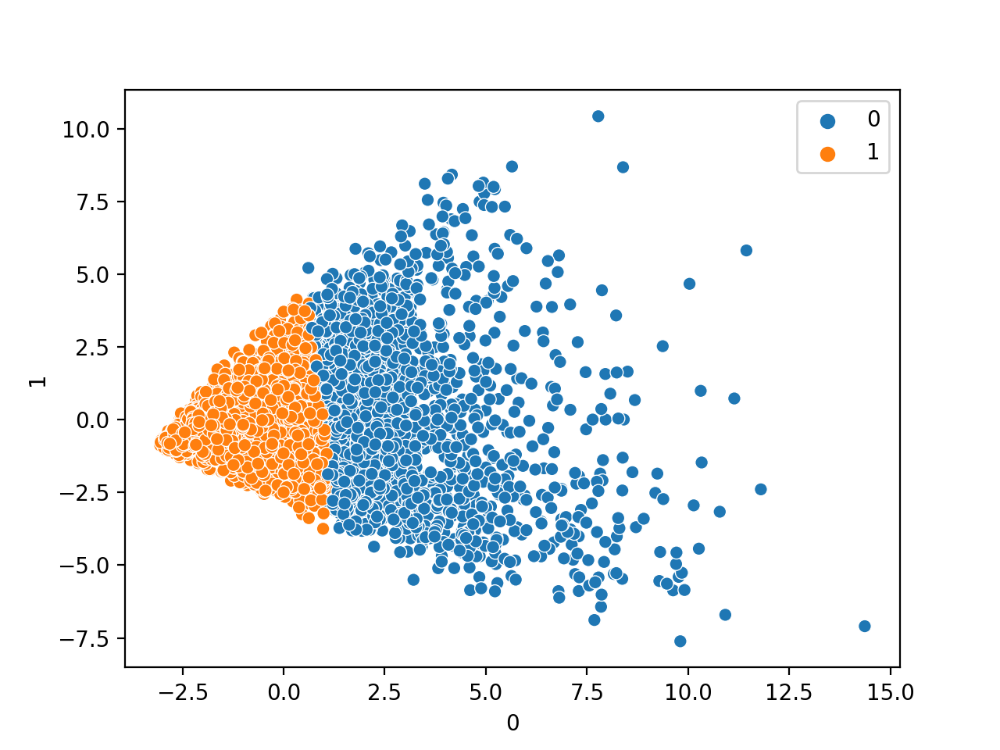

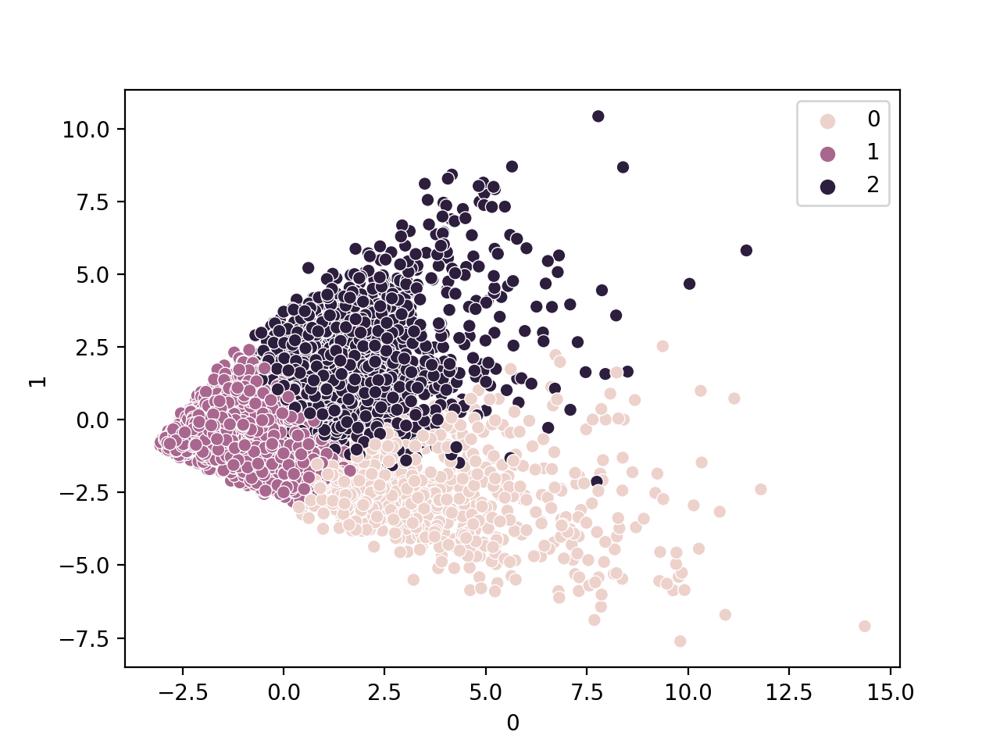

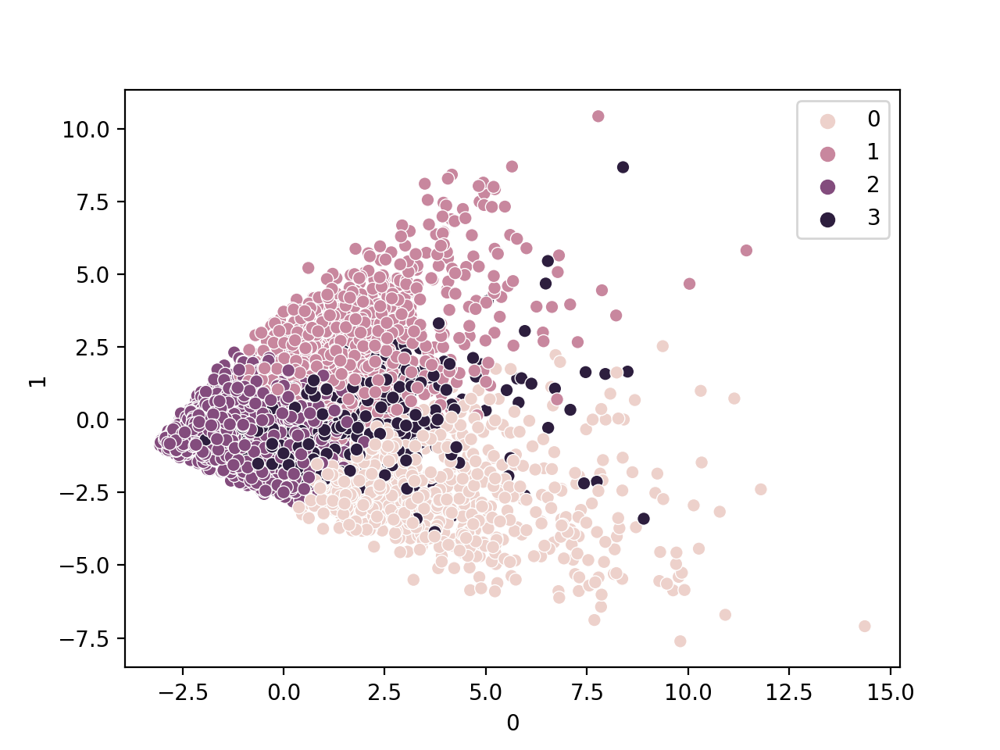

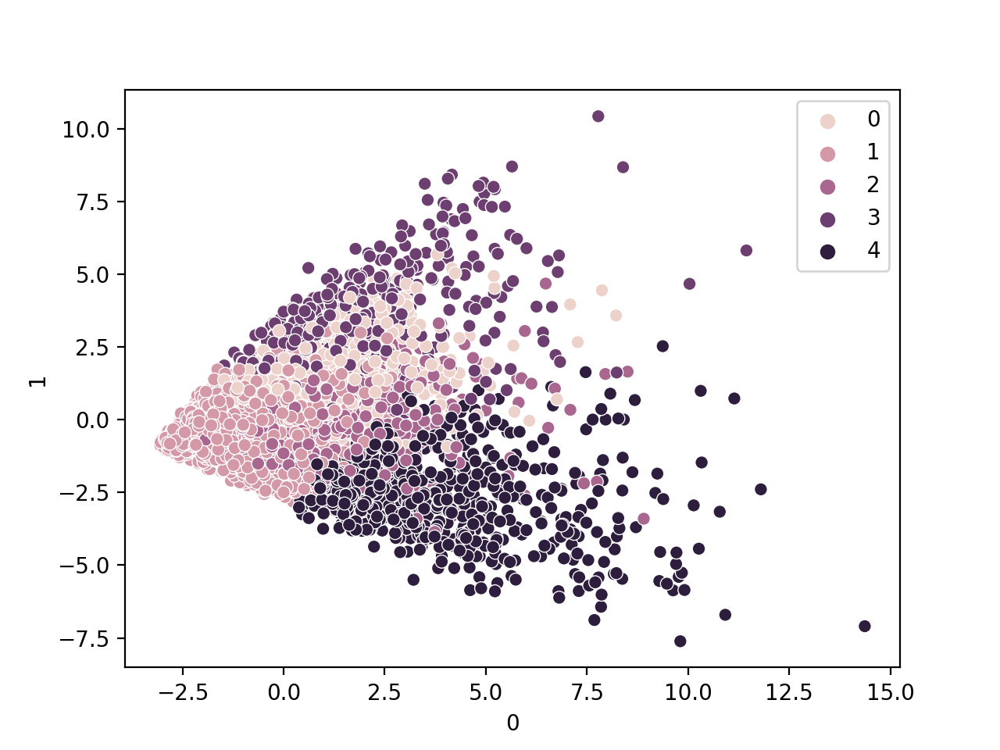

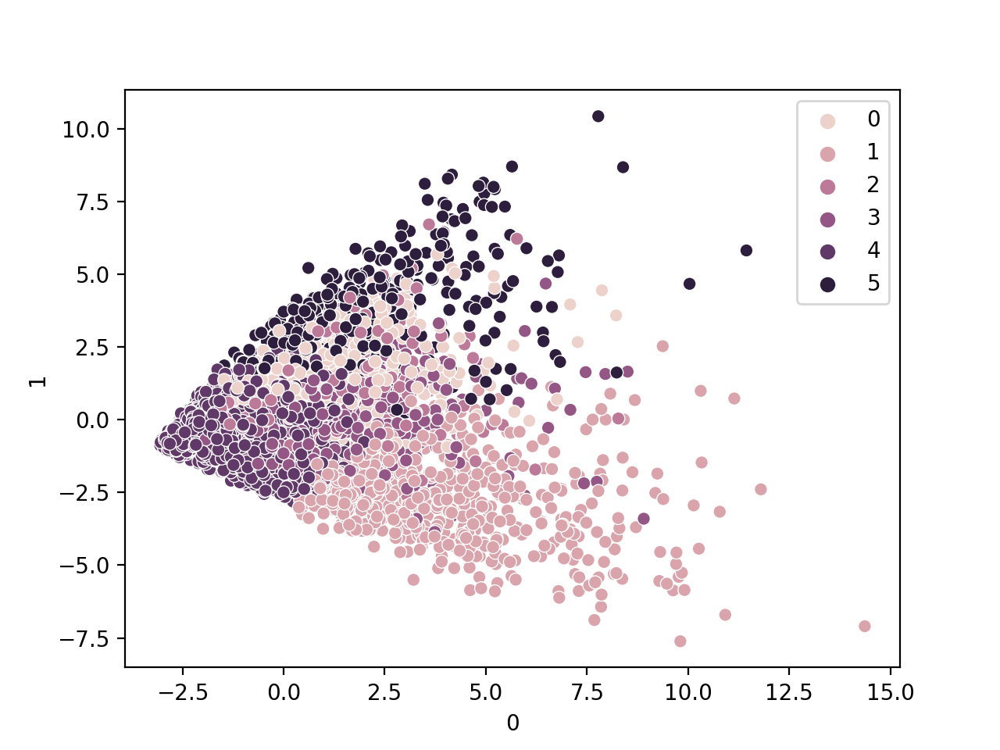

In [53]:

df_pca = pd.DataFrame(PCA(15).fit_transform(ms_scaled))
k = range(2, 7)
for i in k:
    kmeans = KMeans(n_clusters = i, random_state = 1, n_init = 15)
    kmeans.fit(df_pca)
    labels = kmeans.labels_
    sns.scatterplot(data = df_pca, x = df_pca.iloc[:, 0],y = df_pca.iloc[:, 1], hue = labels)
    plt.show()

After PCA, we can see that there are only 3 well defined clusters.Lets define these clusters now.

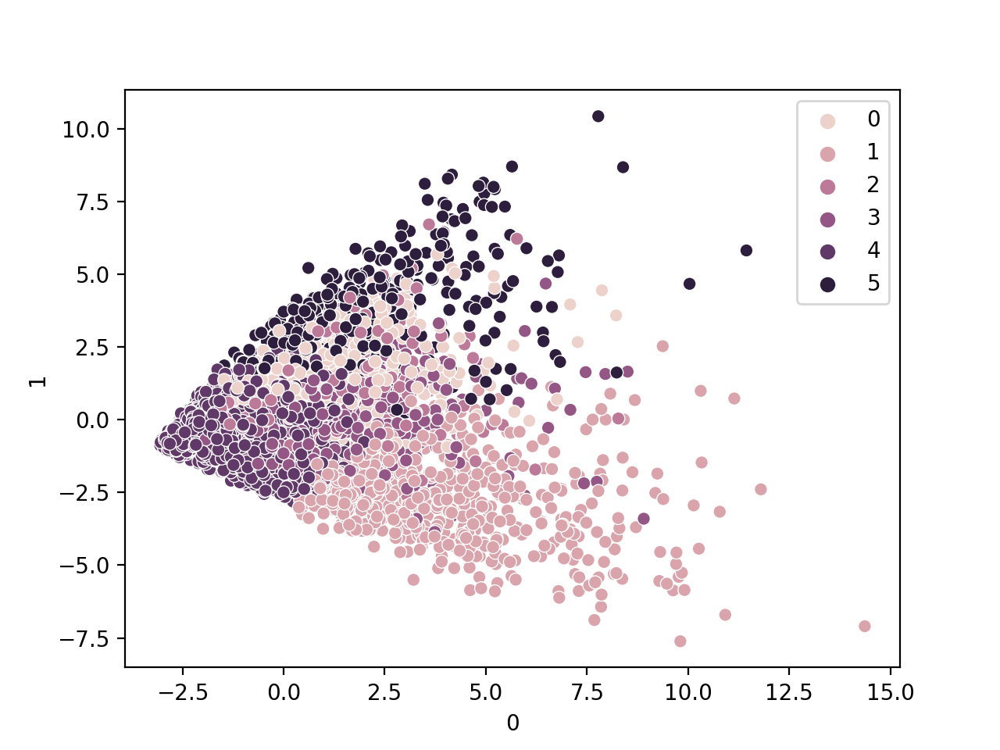

In [54]:
    kmeans = KMeans(n_clusters = 6, random_state = 1, n_init = 15)
    kmeans.fit(df_pca)
    labels = kmeans.labels_
    sns.scatterplot(data = df_pca, x = df_pca.iloc[:, 0],y = df_pca.iloc[:, 1], hue = labels)
    plt.show()

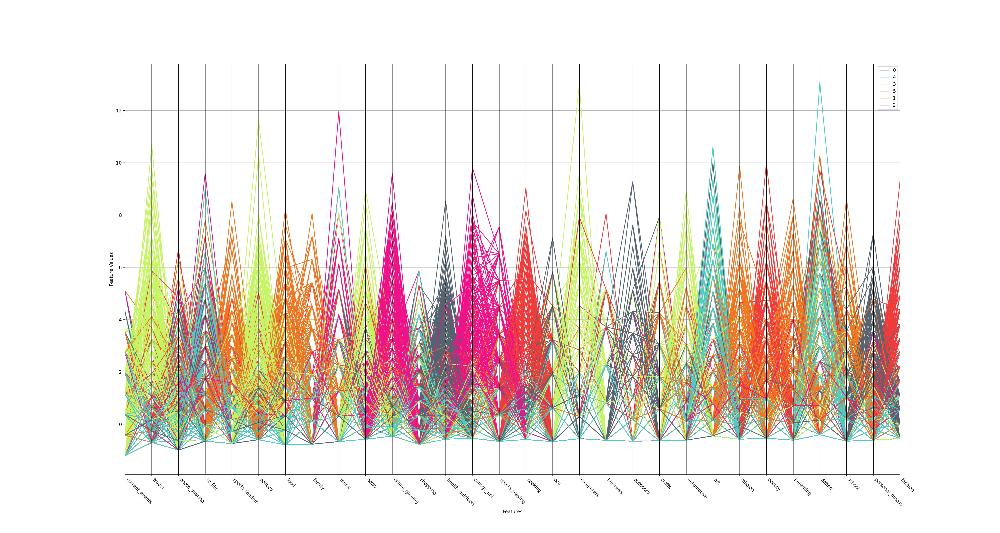

In [55]:
# Add the cluster number to the original scaled data
X_clustered = pd.DataFrame(ms_scaled, index=ms_df_pca.index, columns=ms_df_pca.columns)
X_clustered["cluster"] = labels

unique_clusters = X_clustered["cluster"].unique()

# Plot parallel coordinates for each cluster
# for cluster_label in range(0,2):
# cluster_data = X_clustered[X_clustered["cluster"] == cluster_label]
plt.figure(figsize=(30, 16))
pd.plotting.parallel_coordinates(X_clustered, "cluster", color=('#556270', '#4ECDC4', '#C7F464','#EE3B3B','#EE7621','#EE1289'))
plt.xlabel('Features')
plt.ylabel('Feature Values')
plt.xticks(rotation=-45, ha='left')
plt.show()

There are several intriguing profiles that have emerged from the clusters:

### Cluster 1: 
This group consists of individuals showing focus on tv/film, music, college uni, sports, online gaming and photo sharing. Thus, they represent college going students. 


### Cluster 2:
This group had interests in school, parenting, food, family and religion. So this group consists of middle aged parents.

### Cluster 3: 
This group primarily consists of individuals who show a strong focus on their diet and fitness. They frequently tweet about health nutrition and personal fitness.

### Cluster 4:
This group consists of creative young adults interested in dating, art and film/TV.

### Cluster 5: 
This group consists of people interested in Fashion,Cooking and Beauty. Given the current Gender inclusivity, I dont want to say these are women. It could women, gay men or straight metrosexual individuals. So I will rather just categorize them as aesthetically conscious individuals.

### Cluster 6: 
This segment seems to primarily consist of individuals who engage in conversations about politics, travel,computers,automotive and news. This suggests an interest in current affairs and a more mature outlook.

Each cluster presents a unique profile, offering insights into the diverse interests and demographics of the individuals within them.




